# Edge detection
# <a href="https://colab.research.google.com/github/YoniChechik/AI_is_Math/blob/master/p_03_edge_detection/edge_detection.ipynb" target="_blank" rel="noopener noreferrer"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open in Colab"></a>

## Prep 



In [1]:
# to run in google colab
import sys
if 'google.colab' in sys.modules:
    ! apt-get install subversion
    ! svn checkout https://github.com/YoniChechik/AI_is_Math/trunk/aux_funcs/
    ! svn export https://github.com/YoniChechik/AI_is_Math/trunk/p_03_edge_detection/Bikesgray.jpg
    ! pip install --upgrade bokeh



In [2]:
import numpy as np
import cv2
from matplotlib import pyplot as plt
from aux_funcs import *

fig_size = (10,10)


In [3]:
# to run interactively with vscode
import os
if os.getcwd().endswith("AI_is_Math"):
    os.chdir("p_03_edge_detection")



## Original image


Text(0.5, 1.0, 'Original image')

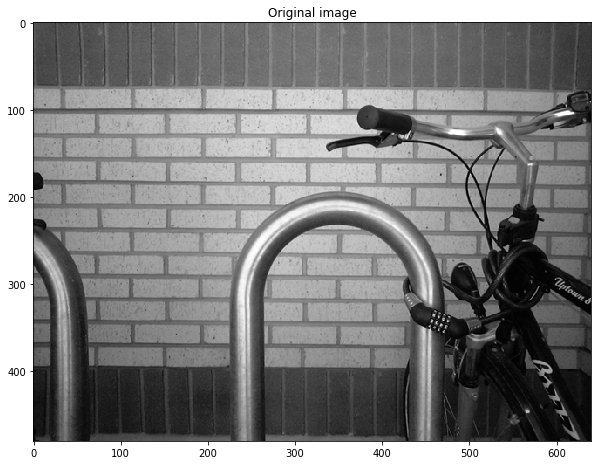

In [4]:
img = cv2.imread("Bikesgray.jpg")
img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
plt.figure(figsize=fig_size)
plt.imshow(img, cmap='gray', vmin=0, vmax=255)
plt.title('Original image')



## Filtering common errors
### kernel errors


Text(0.5, 1.0, "$f'_x$: image filtered with [[-1  0  1]]")

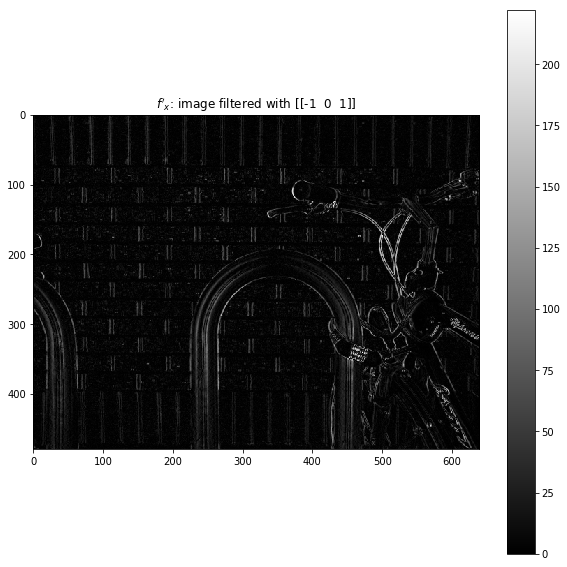

In [5]:
img = img.astype(float)  # 'uint8' doesn't work with minus sign - for filtering

# 1. cv2.filter2D is working with corelation rether than convolution
#    no need to flip the kernel
# 2. Notice that kernel is 2D array - if 1d then column vector
kernel = np.array([[-1, 0, +1]])
dst = cv2.filter2D(img, -1, kernel)

plt.figure(figsize=fig_size)
plt.imshow(np.abs(dst), cmap='gray')
plt.colorbar()
plt.title('$f\'_x$: image filtered with '+str(kernel))



### uint8 errors
Wrong filtering when keeping uint8 instead of float, because uint8 
doesn't have negative numbers...


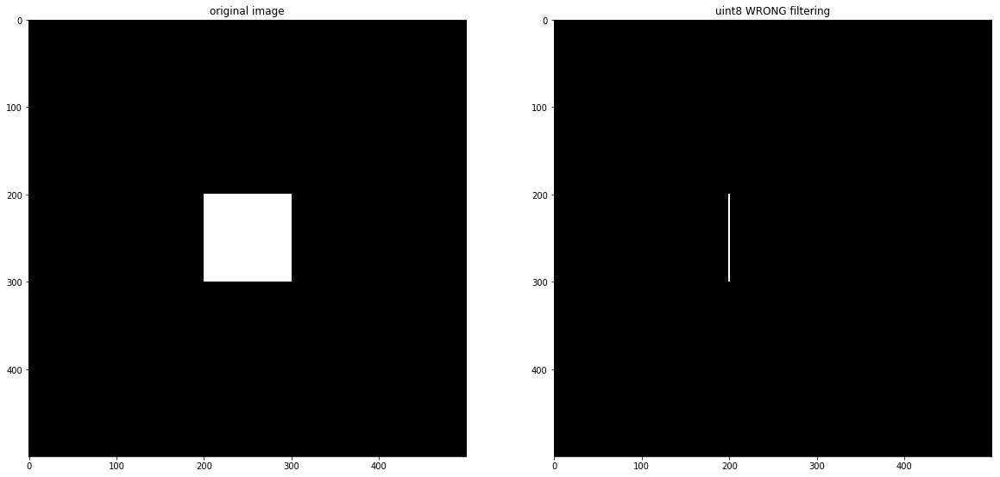

In [6]:
uint8_img = np.zeros((500, 500), dtype=np.uint8)
uint8_img[200:300, 200:300] = 1

kernel = np.array([[-1, 0, +1]])
dst = cv2.filter2D(uint8_img, -1, kernel)

fig, axs = plt.subplots(1, 2, figsize=(20,20))
axs[0].imshow(uint8_img, cmap='gray')
axs[0].title.set_text('original image')
axs[1].imshow(dst, cmap='gray')
axs[1].title.set_text('uint8 WRONG filtering')



## y grad filter


Text(0.5, 1.0, "$f'_y$: image filtered with\n [[-1]\n [ 0]\n [ 1]]")

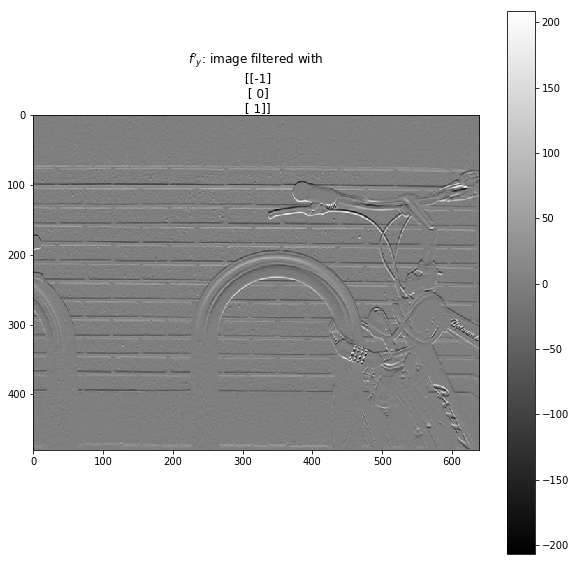

In [7]:
kernel = np.array([[-1, 0, +1]]).T
dst = cv2.filter2D(img, -1, kernel)

plt.figure(figsize=fig_size)
plt.imshow(dst, cmap='gray')
plt.colorbar()
plt.title('$f\'_y$: image filtered with\n '+str(kernel))



## Comparison of x gradient filters


Text(0.5, 1.0, '|symmetric-prewitt|')

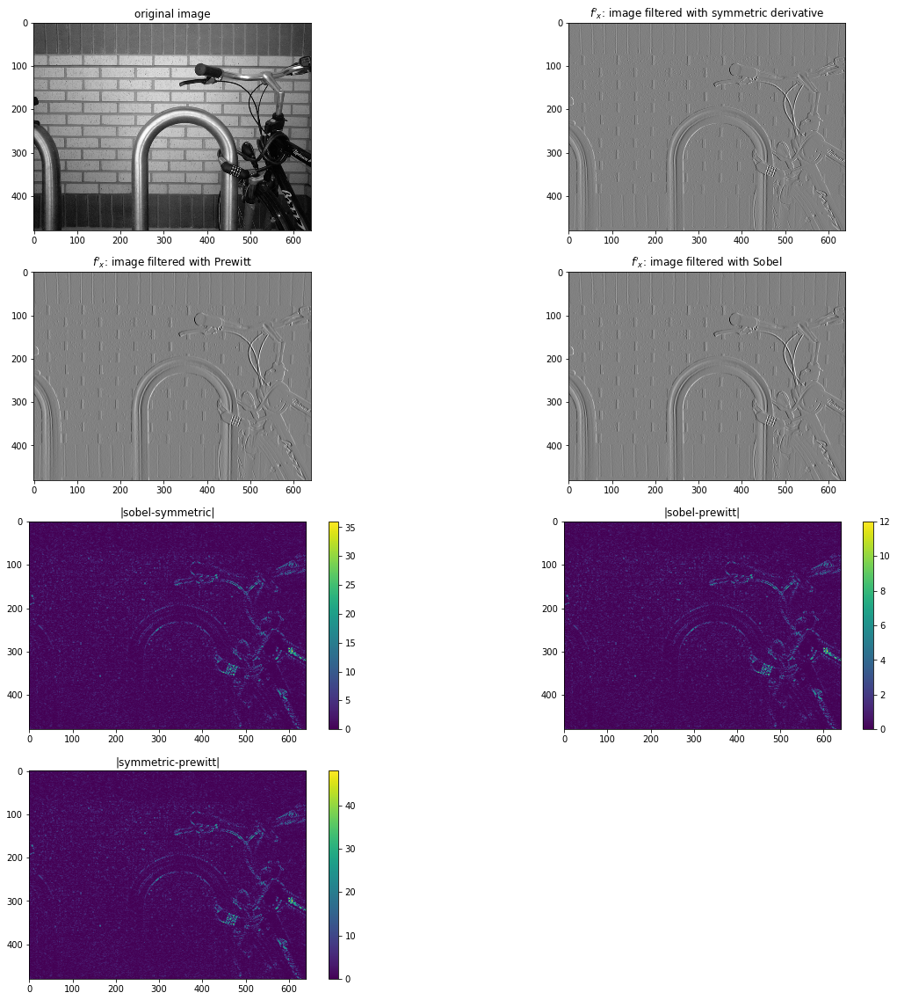

In [8]:
plt.rcParams['figure.figsize'] = [20, 20]

plt.subplot(4, 2, 1)
plt.imshow(img, cmap='gray', vmin=0, vmax=255)
plt.title('original image')

#######################################
kernel = 1/2*np.array([[-1, 0, +1]])
dst_sym = cv2.filter2D(img, -1, kernel)

plt.subplot(4, 2, 2)
plt.imshow(dst_sym, cmap='gray')
plt.title('$f\'_x$: image filtered with symmetric derivative')

#######################################
kernel = 1/6*np.array([
    [-1, 0, +1],
    [-1, 0, +1],
    [-1, 0, +1]])
dst_prewitt = cv2.filter2D(img, -1, kernel)

plt.subplot(4, 2, 3)
plt.imshow(dst_prewitt, cmap='gray')
plt.title('$f\'_x$: image filtered with Prewitt')

#######################################
# cv2.Sobel() also exist
kernel = 1/8*np.array([
    [-1, 0, +1],
    [-2, 0, +2],
    [-1, 0, +1]])
dst_sobel = cv2.filter2D(img, -1, kernel)

plt.subplot(4, 2, 4)
plt.imshow(dst_sobel, cmap='gray')
plt.title('$f\'_x$: image filtered with Sobel')

#######################################
plt.subplot(4, 2, 5)
plt.imshow(np.abs(dst_sobel-dst_sym))
plt.colorbar()
plt.title('|sobel-symmetric|')

#######################################
plt.subplot(4, 2, 6)
plt.imshow(np.abs(dst_sobel-dst_prewitt))
plt.colorbar()
plt.title('|sobel-prewitt|')

#######################################
plt.subplot(4, 2, 7)
plt.imshow(np.abs(dst_sym-dst_prewitt)) 
plt.colorbar()
plt.title('|symmetric-prewitt|')


## Magnitude and phase images



In [9]:
kernel = 1/8*np.array([
    [-1, 0, +1],
    [-2, 0, +2],
    [-1, 0, +1]])
sobel_x = cv2.filter2D(img, -1, kernel)

kernel = kernel.T
sobel_y = cv2.filter2D(img, -1, kernel)

mag_img = np.sqrt(sobel_x**2+sobel_y**2)

phase_img = cv2.phase(sobel_x, -sobel_y, angleInDegrees=True)

phase_img_masked = -100*np.ones(phase_img.shape)
TH_PRC = 0.15
th = mag_img.max()*TH_PRC
phase_img_masked = phase_img_masked*(mag_img <= th) + phase_img*(mag_img > th)


bokeh_imshow(mag_img, scale=1, colorbar=True,
             show=True, title='Gradient magnitude')

bokeh_imshow(phase_img_masked, scale=1, colorbar=True,
             show=True, title='Gradient phase thresholeded')



Loading BokehJS ...

Loading BokehJS ...

Figure(id='1119', ...)

## Edge thinning 
### LoG filter
First we will see why edge thinning with second derivative like LoG is bad



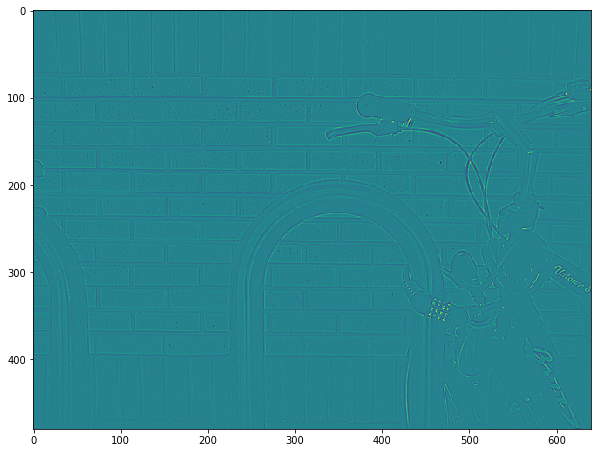

In [10]:
blur = cv2.blur(img, (1, 1))
kernel = np.array([
    [-1, -1, -1],
    [-1, 8, -1],
    [-1, -1, -1]])
dst_sobel = cv2.filter2D(blur, -1, kernel)

plt.figure(figsize=fig_size)
plt.imshow(dst_sobel)


### Naive way for zero crossings


Text(0.5, 1.0, 'Naive way for zero crossings')

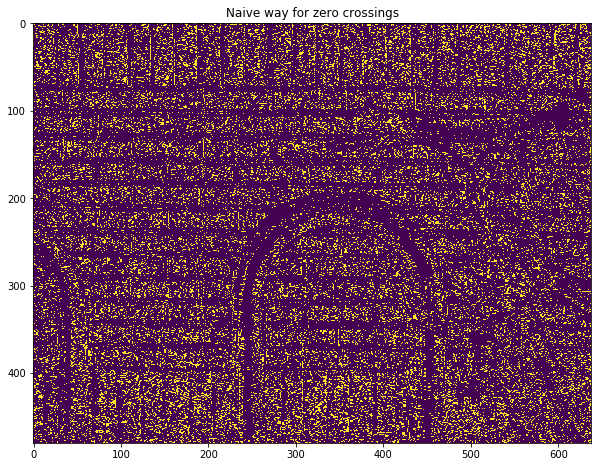

In [11]:
sign_im = dst_sobel > 0
sign_im_left = sign_im[:, :-1]
sign_im_right = sign_im[:, 1:]
res = np.logical_xor(sign_im_left, sign_im_right)

sign_im_left = res[:, 1:]
sign_im_right = res[:, :-1]
res = np.logical_and(sign_im_left, sign_im_right)

plt.figure(figsize=fig_size)
plt.imshow(res)
plt.title('Naive way for zero crossings')




It's hard to find zero crossing in an image!! this is why LoG is not in use for edge thinning.

## NMS preliminary step: Quantizing the phase image



In [12]:
phase_img_q = phase_img.copy()
for i in range(mag_img.shape[0]):
    for j in range(mag_img.shape[1]):
        phase_img_q[i, j] = np.mod(phase_img_q[i, j]+22.5, 180)
        phase_img_q[i, j] = (phase_img_q[i, j])//45  # integer devider

phase_img_q_masked = -1*np.ones(phase_img.shape)
TH_PRC = 0.1
th = mag_img.max()*TH_PRC
phase_img_q_masked = phase_img_q_masked * \
    (mag_img <= th) + phase_img_q*(mag_img > th)

bokeh_imshow(phase_img_q_masked, scale=1, colorbar=True, show=True,
             title='Gradient phase- quantized and thresholded')




Loading BokehJS ...

Figure(id='1249', ...)

## NMS



In [13]:
nms = mag_img.copy()

for i in range(1, mag_img.shape[0]-1):
    for j in range(1, mag_img.shape[1]-1):
        if phase_img_q[i, j] == 0 and (mag_img[i, j+1] > mag_img[i, j] or mag_img[i, j-1] > mag_img[i, j]):
            nms[i, j] = -50
        if phase_img_q[i, j] == 1 and (mag_img[i+1, j-1] > mag_img[i, j] or mag_img[i-1, j+1] > mag_img[i, j]):
            nms[i, j] = -50
        if phase_img_q[i, j] == 2 and (mag_img[i-1, j] > mag_img[i, j] or mag_img[i+1, j] > mag_img[i, j]):
            nms[i, j] = -50
        if phase_img_q[i, j] == 3 and (mag_img[i-1, j-1] > mag_img[i, j] or mag_img[i+1, j+1] > mag_img[i, j]):
            nms[i, j] = -50

bokeh_imshow(nms, scale=1, colorbar=True, show=True, title='NMS')



Loading BokehJS ...

Figure(id='1389', ...)

## double TH



In [14]:
nms_th = np.zeros(nms.shape)
TH_l = 3
TH_h = 13
nms_th[nms >= TH_h] = 2
nms_th[np.bitwise_and(TH_l <= nms, nms < TH_h)] = 1

bokeh_imshow(nms_th, scale=1, colorbar=True, title='double TH')



Loading BokehJS ...

Figure(id='1539', ...)

## Iterative hysteresis
We will do the iterative process with connected components (CC):
1. Take a mask of combined weak and strong edges and run CC algorithm on it.
2. For each such CC group- test if there is intersection with ONLY strong edges mask.
3. If intersection exist, then weak edges in CC group is actually strong edges, so unite the masks.



In [15]:

nms_weak_and_strong = np.zeros(nms_th.shape,dtype=np.bool)
nms_strong = np.zeros(nms_th.shape,dtype=np.bool)

nms_weak_and_strong[nms_th>0]=1
nms_strong[nms_th==2]=1

num_w_s_CCs, w_s_CC_mask = cv2.connectedComponents(nms_weak_and_strong.astype(np.uint8))

# for each CC group of weak and strong edge mask
for w_s_CC_i in range(1,num_w_s_CCs):

    # get MASK of weak_and_strong edge from index w_s_CC_i
    w_s_CC_mask_i = np.zeros(nms_th.shape,dtype=np.bool)
    w_s_CC_mask_i[w_s_CC_mask==w_s_CC_i]=1

    # if w_s_CC_mask_i has intersection with strong edges mask, add to strong edge mask
    if np.any(np.bitwise_and(w_s_CC_mask_i, nms_strong)):
        nms_strong = np.bitwise_or(w_s_CC_mask_i, nms_strong)

bokeh_imshow(nms_strong, scale=1, colorbar=True, title='Canny final result')



Loading BokehJS ...

Figure(id='1699', ...)

## cv2 Canny
let's see the results from the default canny of cv2


In [16]:
res = cv2.Canny(img.astype(np.uint8),105,120)
bokeh_imshow(res, scale=1, title='cv2.Canny final result')


Loading BokehJS ...

Figure(id='1869', ...)